In [2]:
# title Install dependencies
!pip install seaborn --quiet
!pip install nilearn --quiet

In [3]:
# import libraies
import os
import shutil
import requests
import tarfile
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from nilearn import plotting, datasets

# Figure settings
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.style.use("https://raw.githubusercontent.com/NeuromatchAcademy/course-content/main/nma.mplstyle")

# information
N_SUBJECTS = 339
N_PARCELS = 360
TR = 0.72  # Time resolution, in seconds
HEMIS = ["Right", "Left"]
N_RUNS = 2
EXPERIMENTS = {
    'MOTOR': {'runs': [5, 6], 'cond': ['lf', 'rf', 'lh', 'rh', 't', 'cue']},
    'WM': {'runs': [7, 8], 'cond': ['0bk_body', '0bk_faces', '0bk_places', '0bk_tools', '2bk_body', '2bk_faces', '2bk_places', '2bk_tools']},
    'EMOTION': {'runs': [9, 10], 'cond': ['fear', 'neut']},
    'GAMBLING': {'runs': [11, 12], 'cond': ['loss', 'win']},
    'LANGUAGE': {'runs': [13, 14], 'cond': ['math', 'story']},
    'RELATIONAL': {'runs': [15, 16], 'cond': ['match', 'relation']},
    'SOCIAL': {'runs': [17, 18], 'cond': ['mental', 'rnd']}
}

subjects = range(N_SUBJECTS)
# print(subjects)

HCP_DIR = r"/home/amirreza/neuromatch/hcp_task"
# if os.path.exists(HCP_DIR) == True:
#     print("Found directory")
# else:
#     print("Noy Found directory")

In [4]:
def load_single_timeseries(subject, experiment, run, dir, remove_mean=True):
   """Load timeseries data for a single subject and single run.


   Args:
       subject (str): Subject ID to load
       experiment (str): Name of experiment
       run (int): 0-based run index (0 or 1 for the task)
       dir (str): Path to HCP directory
       remove_mean (bool): If True, subtract the parcel-wise mean


   Returns:
       ts (n_parcel x n_timepoint array): Array of BOLD data values
   """
   bold_run = EXPERIMENTS[experiment]['runs'][run]
   # Corrected path: Removed the extra "hcp_task"
   bold_path = os.path.join(dir, "subjects", str(subject), "timeseries")
   bold_file = f"bold{bold_run}_Atlas_MSMAll_Glasser360Cortical.npy"
   ts = np.load(os.path.join(bold_path, bold_file))
   if remove_mean:
       ts -= ts.mean(axis=1, keepdims=True)
   return ts

def load_evs(subject, experiment, run, dir):
   """Load EVs (explanatory variables) data for one task experiment.


   Args:
       subject (str): Subject ID to load
       experiment (str): Name of experiment
       run (int): 0-based run index (0 or 1 for the task)
       dir (str): Path to HCP directory


   Returns:
       evs (list of lists): A list of frames associated with each condition, clipped to valid timepoints
   """
   frames_list = []
   task_key = 'tfMRI_' + experiment + '_' + ['RL', 'LR'][run]
   # Load time series to get number of timepoints
   try:
       ts = load_single_timeseries(subject, experiment, run, dir, remove_mean=False)
       n_timepoints = ts.shape[1]
   except Exception as e:
       print(f"Error loading time series for {subject}/{experiment}/bold{EXPERIMENTS[experiment]['runs'][run]} to clip frames: {e}")
       return None


   for cond in EXPERIMENTS[experiment]['cond']:
       # Corrected path: Removed the extra "hcp_task"
       ev_file = os.path.join(dir, "subjects", str(subject), "EVs", task_key, f"{cond}.txt")
       try:
           ev_array = np.loadtxt(ev_file, ndmin=2, unpack=True)
           ev = dict(zip(["onset", "duration", "amplitude"], ev_array))
           # Determine when trial starts, rounded down
           start = np.floor(ev["onset"] / TR).astype(int)
           # Use trial duration to determine how many frames to include for trial
           duration = np.ceil(ev["duration"] / TR).astype(int)
           # Take the range of frames that correspond to this specific trial
           frames = [s + np.arange(0, d) for s, d in zip(start, duration)]
           # Clip frames to valid timepoints
           clipped_frames = []
           for frame in frames:
               valid_frames = frame[frame < n_timepoints]
               if len(valid_frames) > 0:
                   clipped_frames.append(valid_frames)
           frames_list.append(clipped_frames if clipped_frames else [])
       except Exception as e:
           print(f"Error loading EV file {ev_file}: {e}")
           frames_list.append([])


   return frames_list

def load_saved_condition_data(conditions, save_dir):
    wm_data = {}
    for cond in conditions:
        path = os.path.join(save_dir, f"{cond}.npy")
        if os.path.exists(path):
            wm_data[cond] = np.load(path)
            print(f"Loaded {cond} → shape: {wm_data[cond].shape}")
        else:
            print(f"Missing: {cond}")
    return wm_data

In [5]:
#  Regions And Networks
regions = np.load(os.path.join(HCP_DIR, "regions.npy")).T
# print(regions.shape)
region_info = dict(name=regions[0].tolist(),
                   network=regions[1],
                   hemi=['Right']*int(N_PARCELS/2) + ['Left']*int(N_PARCELS/2))
# print(region_info['name'][:10])
# print(region_info['network'][:10])

# loading concatenated_data
SAVE_DIR = r"/home/amirreza/neuromatch/hcp_task/concatenated_data"
all_wm_conditions = EXPERIMENTS["WM"]["cond"]  # ['0bk_body', ..., '2bk_tools']
wm_data = load_saved_condition_data(all_wm_conditions, SAVE_DIR)
# print(wm_data.keys())

Loaded 0bk_body → shape: (339, 360, 78)
Loaded 0bk_faces → shape: (339, 360, 78)
Loaded 0bk_places → shape: (339, 360, 78)
Loaded 0bk_tools → shape: (339, 360, 78)
Loaded 2bk_body → shape: (339, 360, 78)
Loaded 2bk_faces → shape: (339, 360, 78)
Loaded 2bk_places → shape: (339, 360, 78)
Loaded 2bk_tools → shape: (339, 360, 78)


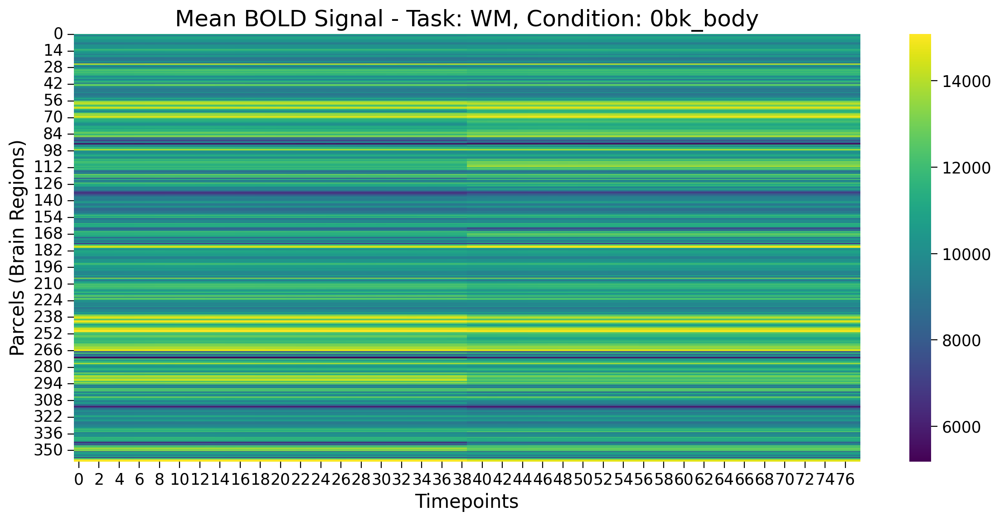

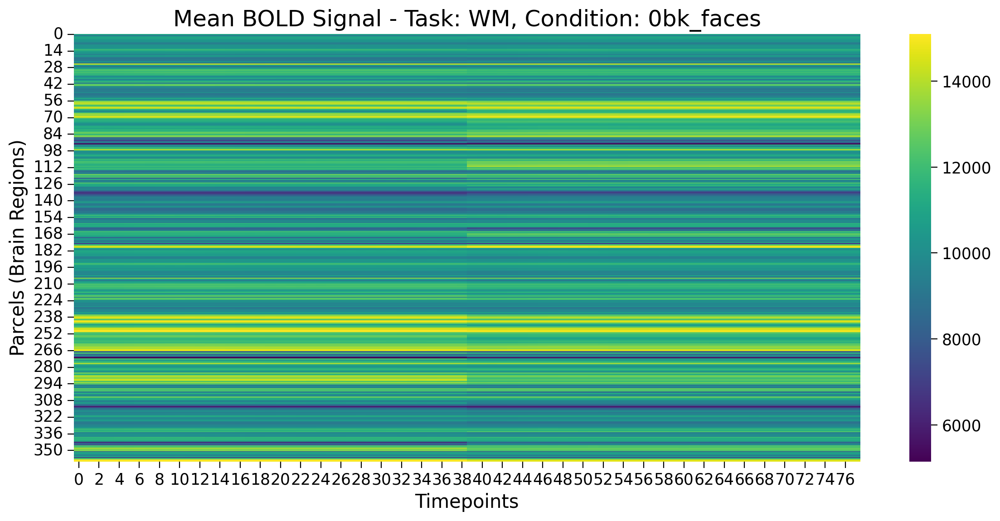

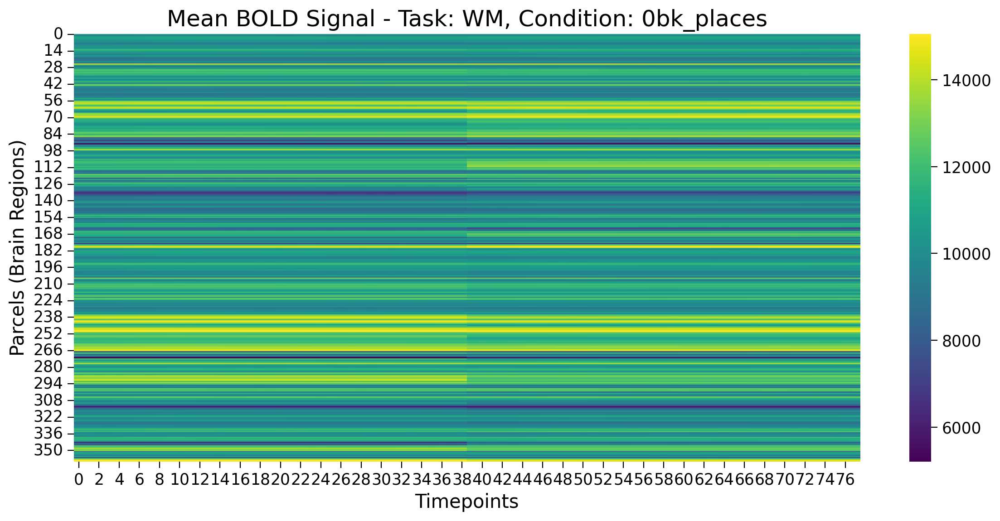

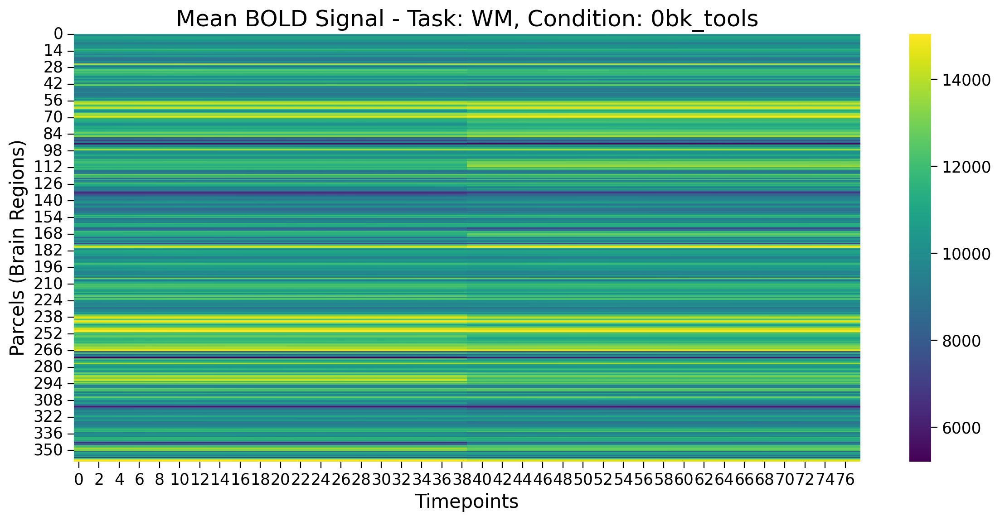

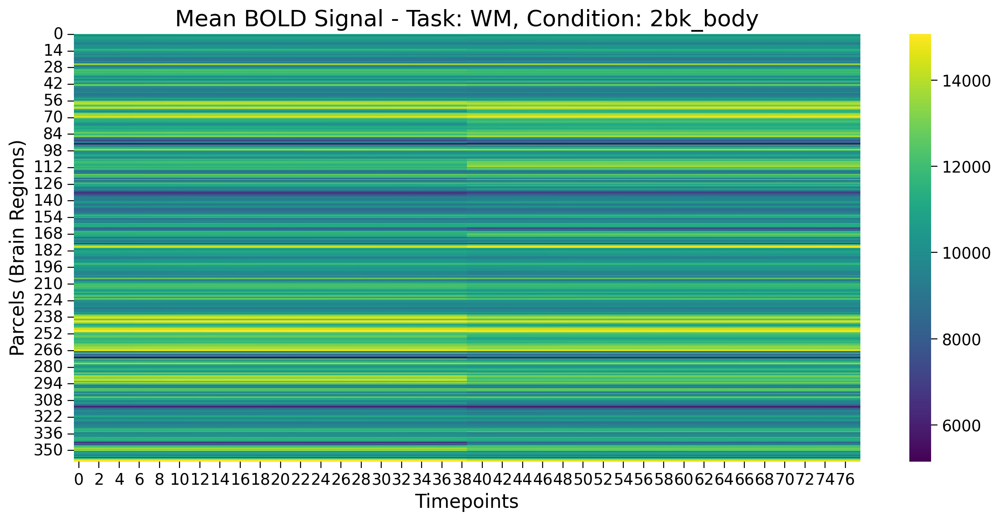

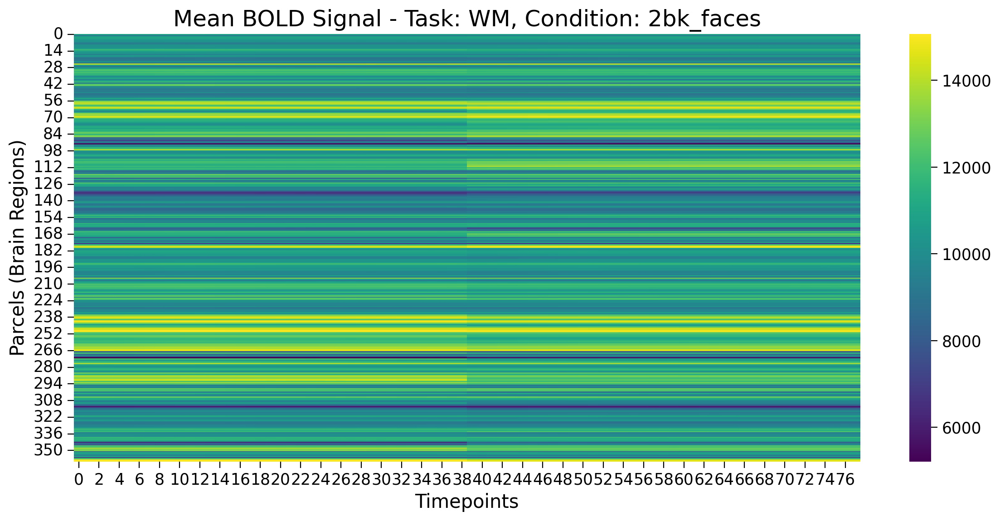

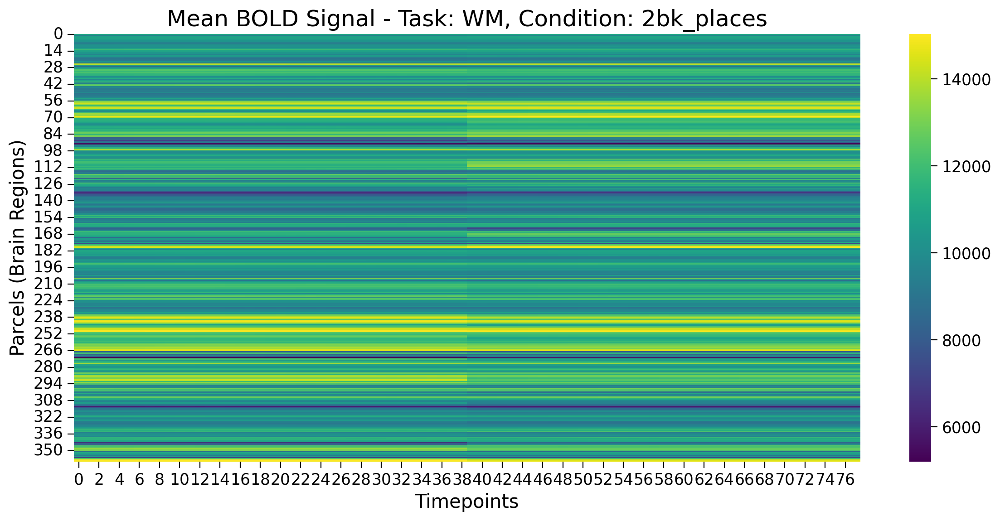

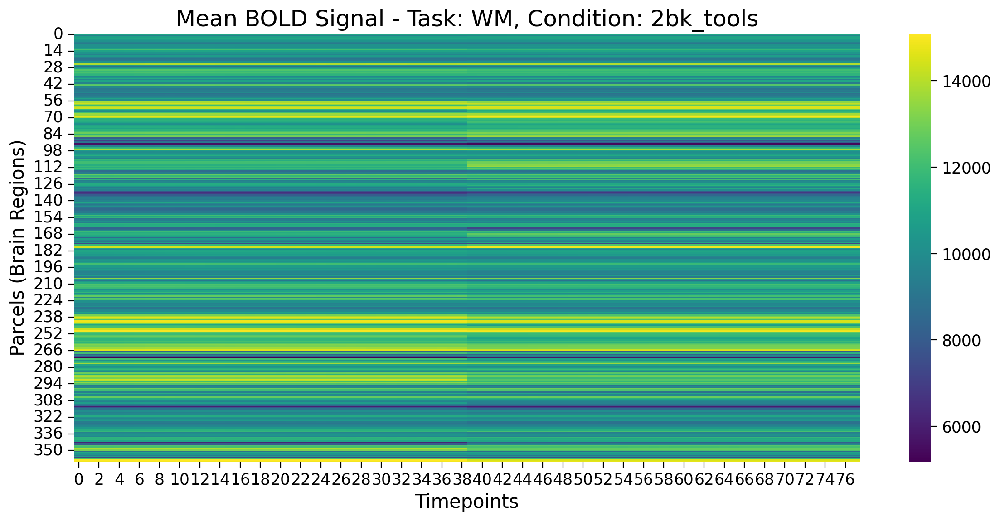

In [6]:
task = "WM"
conditions = EXPERIMENTS[task]["cond"]

for condition, data in wm_data.items():
    mean_data = data.mean(axis=0)

    plt.figure(figsize=(12, 6))
    sns.heatmap(mean_data, cmap='viridis', cbar=True)
    plt.title(f"Mean BOLD Signal - Task: {task}, Condition: {condition}")
    plt.xlabel("Timepoints")
    plt.ylabel("Parcels (Brain Regions)")
    plt.tight_layout()
    plt.show()

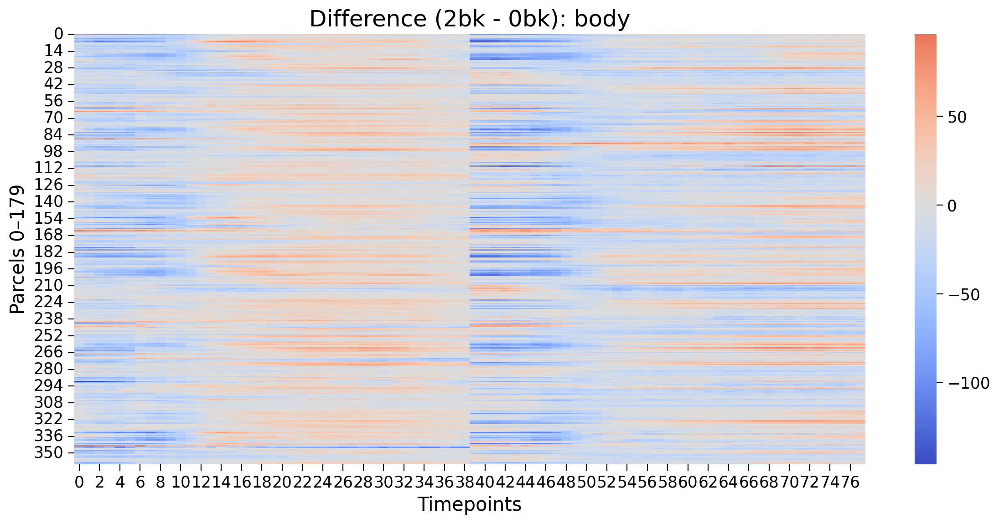

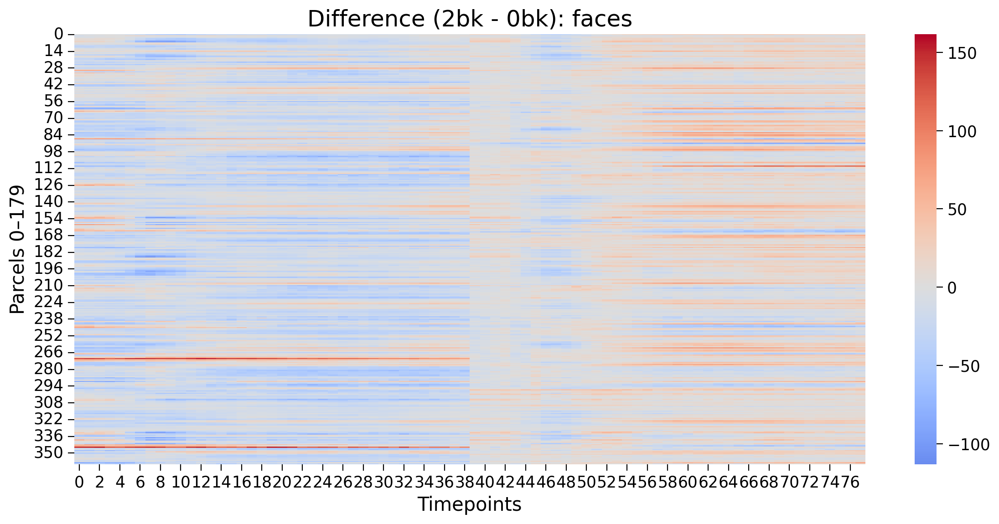

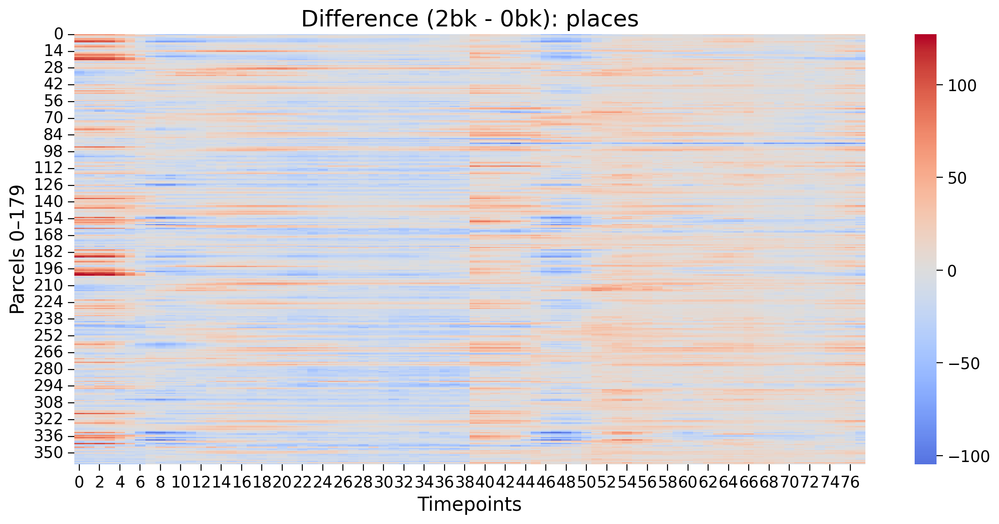

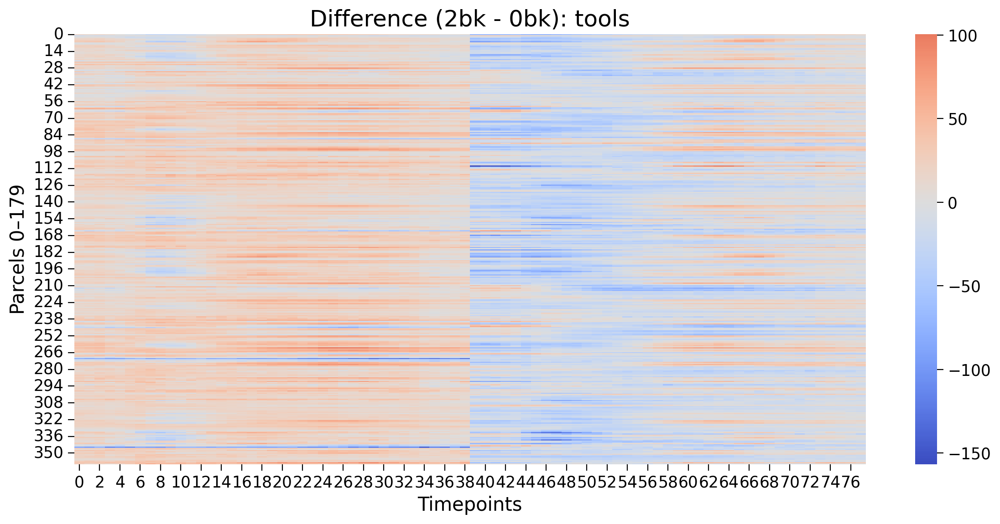

In [7]:
categories = ["body", "faces", "places", "tools"]
n_parcels = 360

for cat in categories:
    cond_0bk = f"0bk_{cat}"
    cond_2bk = f"2bk_{cat}"

    if cond_0bk in wm_data and cond_2bk in wm_data:

        mean_0bk = wm_data[cond_0bk].mean(axis=0)[:n_parcels, :]
        mean_2bk = wm_data[cond_2bk].mean(axis=0)[:n_parcels, :]


        diff = mean_2bk - mean_0bk  # shape: (180, 78)


        plt.figure(figsize=(12, 6))
        sns.heatmap(diff, cmap='coolwarm', center=0, cbar=True)
        plt.title(f"Difference (2bk - 0bk): {cat}")
        plt.xlabel("Timepoints")
        plt.ylabel("Parcels 0–179")
        plt.tight_layout()
        plt.show()
    else:
        print(f"⛔ Missing data for: {cond_0bk} or {cond_2bk}")

In [8]:
def compute_and_plot_avg_correlations(task, cond, region_info, result):
    """
    Given preloaded data `result` (shape: [n_subjects, 360, T]),
    computes and plots the subject‐average parcel×parcel and network×network
    correlation matrices for the specified task and condition.

    Returns:
      avg_corr_parcels  : np.ndarray (360×360)
      avg_corr_networks : pd.DataFrame (N_networks×N_networks)
    """
    data   = result
    n_subj = data.shape[0]

    # 1. Average parcel×parcel correlations
    sum_parc = np.zeros((360, 360))
    for s in range(n_subj):
        sum_parc += np.corrcoef(data[s])
    avg_parc = sum_parc / n_subj

    # 2. Average network×network correlations
    networks    = np.unique(region_info["network"])
    sum_nets_df = pd.DataFrame(0., index=networks, columns=networks)
    for s in range(n_subj):
        df     = pd.DataFrame(data[s].T, columns=region_info["network"])
        net_ts = df.T.groupby(level=0).mean().T
        sum_nets_df += net_ts.corr()
    avg_nets = sum_nets_df / n_subj

    # 3. Plot avg_parc (static)
    plt.figure(figsize=(14,12))
    sns.heatmap(avg_parc, cmap="vlag", center=0, square=True,
                cbar_kws={"shrink":0.5})
    plt.title(f"Avg Parcel Corr | {task} {cond}", fontsize=18)
    plt.xlabel("Parcel"); plt.ylabel("Parcel")
    plt.tight_layout(); plt.show()

    # 4. Plot avg_parc (interactive)
    fig1 = px.imshow(avg_parc,
                     labels=dict(x="Parcel", y="Parcel", color="Correlation"),
                     title=f"Avg Parcel Corr (Interactive) | {task} {cond}",
                     color_continuous_scale="RdBu", zmin=-1, zmax=1)
    fig1.update_layout(width=900, height=900)
    fig1.show()

    # 5. Plot avg_nets (static)
    plt.figure(figsize=(10,8))
    sns.heatmap(avg_nets, cmap="coolwarm", center=0,
                annot=True, fmt=".2f", annot_kws={"fontsize":14},
                cbar_kws={"shrink":0.7})
    plt.title(f"Avg Network Corr | {task} {cond}", fontsize=18)
    plt.xlabel("Network"); plt.ylabel("Network")
    plt.tight_layout(); plt.show()

    # 6. Plot avg_nets (interactive)
    fig2 = px.imshow(avg_nets,
                     labels=dict(x="Network", y="Network", color="Correlation"),
                     title=f"Avg Network Corr (Interactive) | {task} {cond}",
                     color_continuous_scale="RdBu", zmin=-1, zmax=1)
    fig2.update_layout(width=800, height=800, font=dict(size=12))
    fig2.show()

    return avg_parc, avg_nets

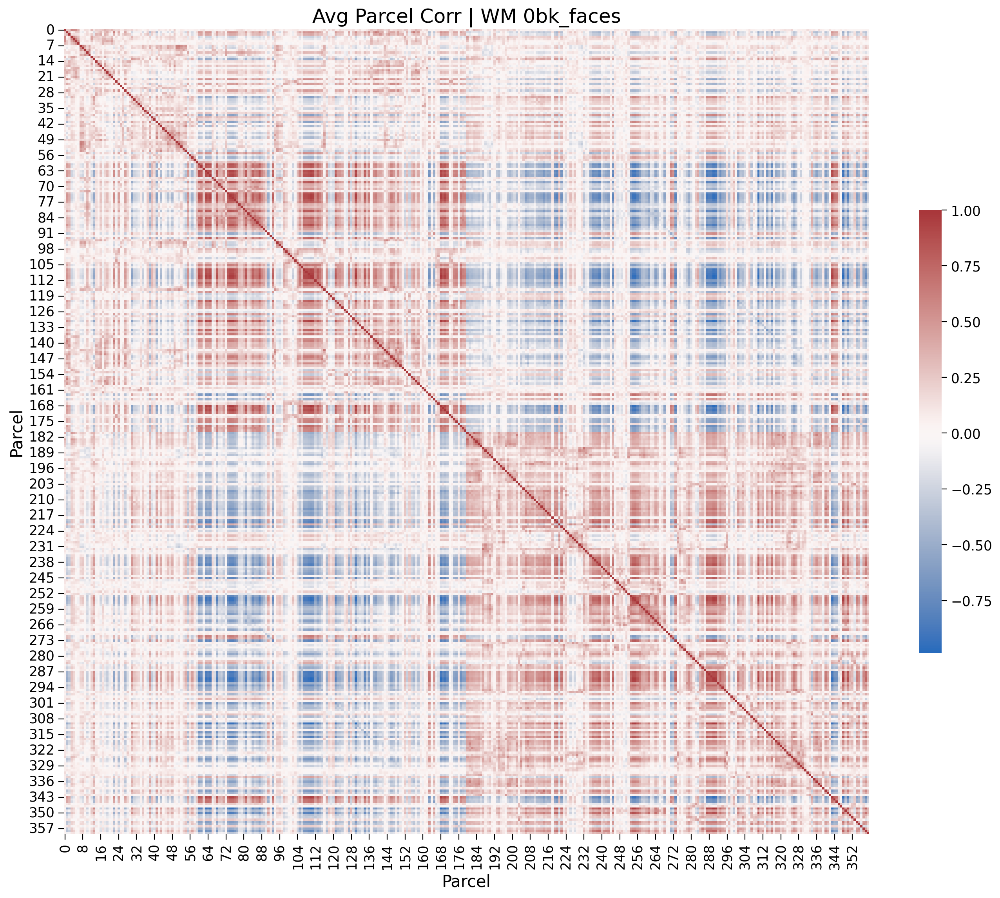

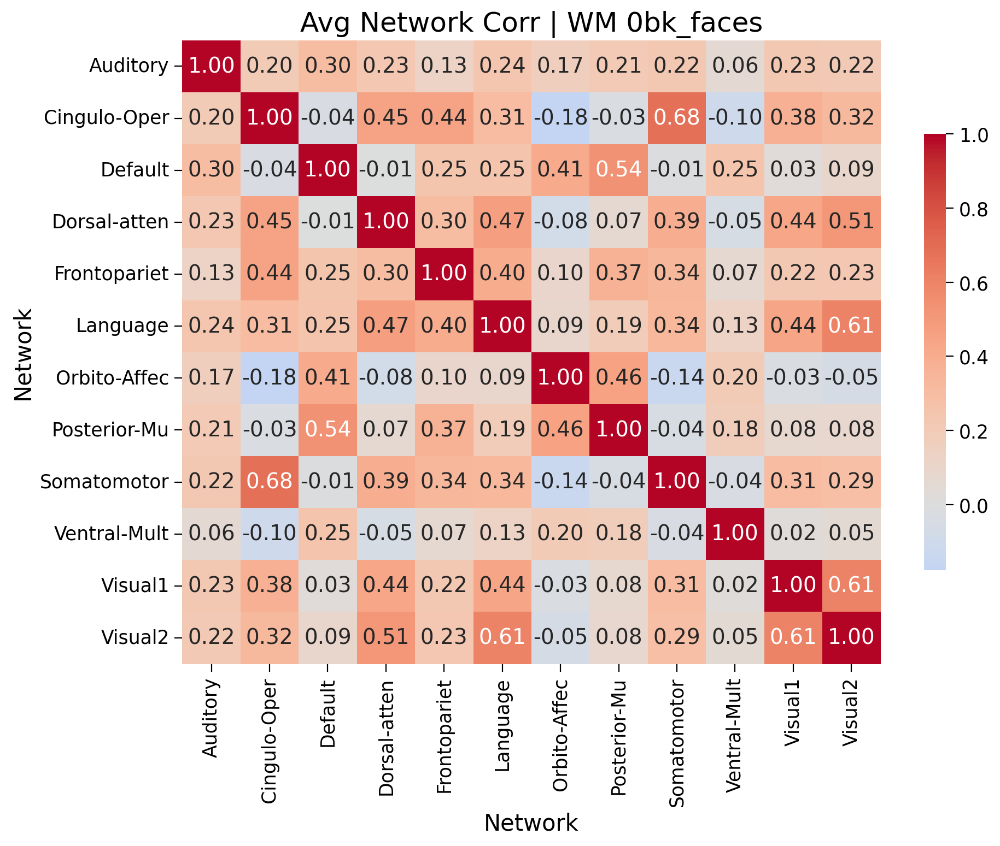

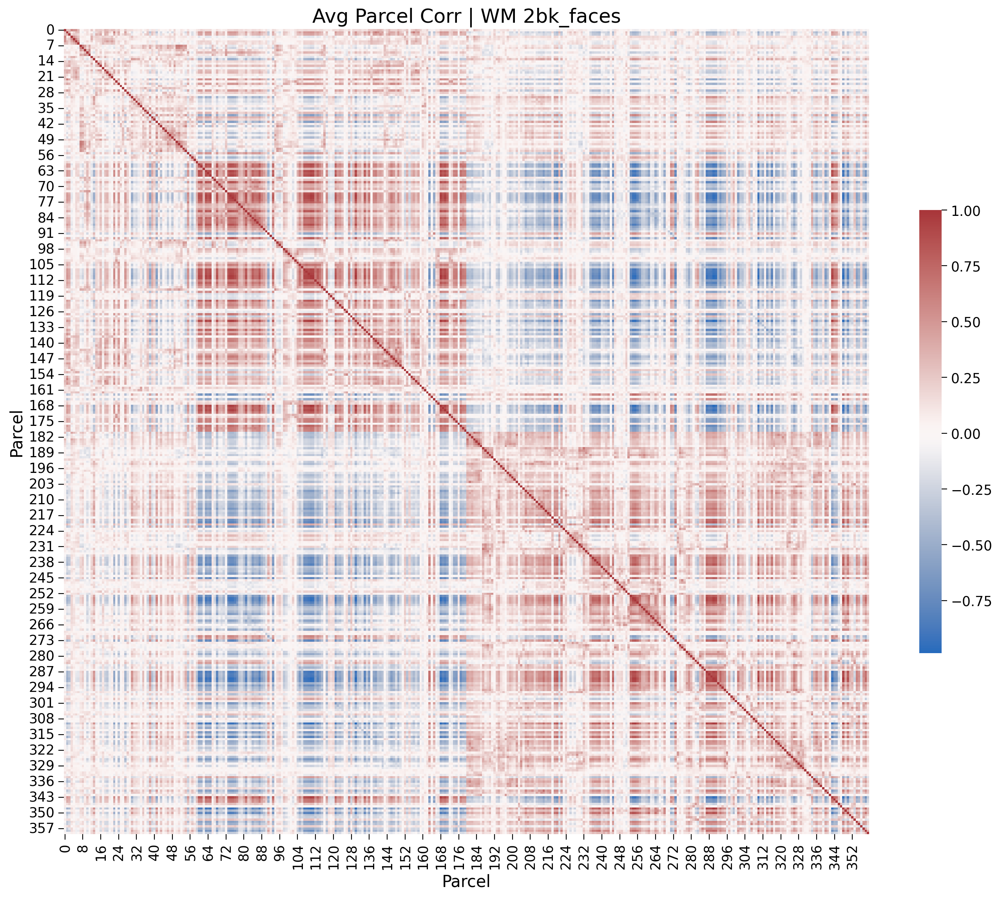

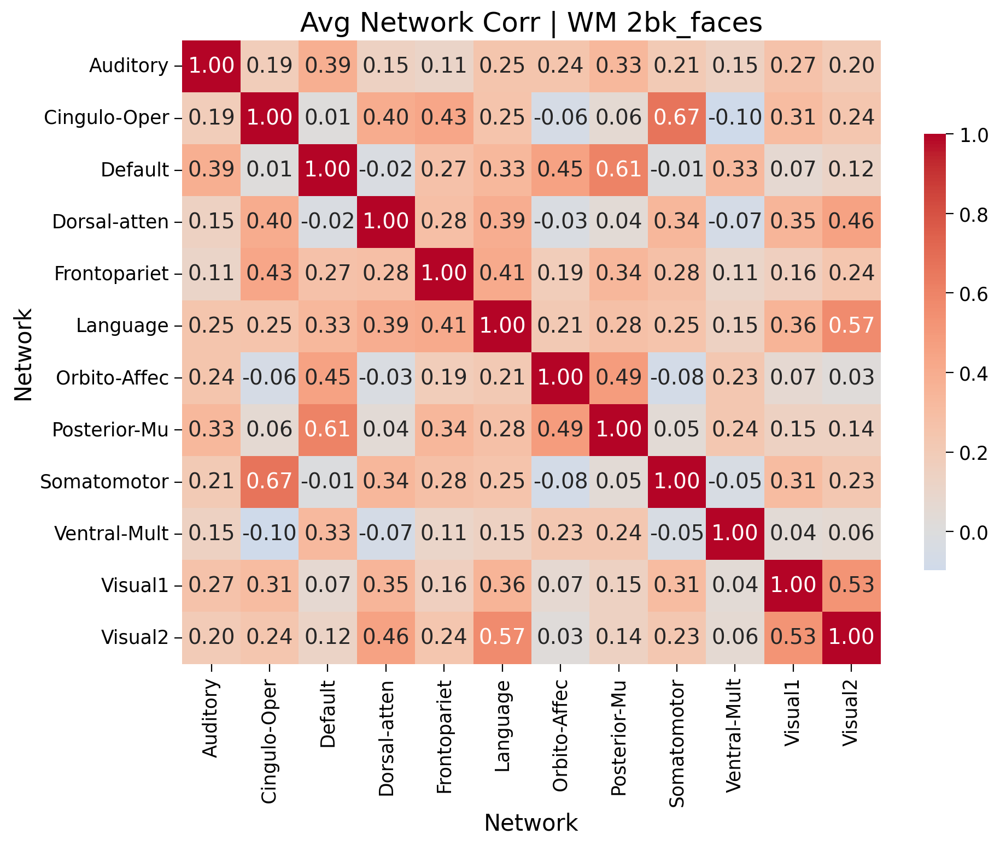

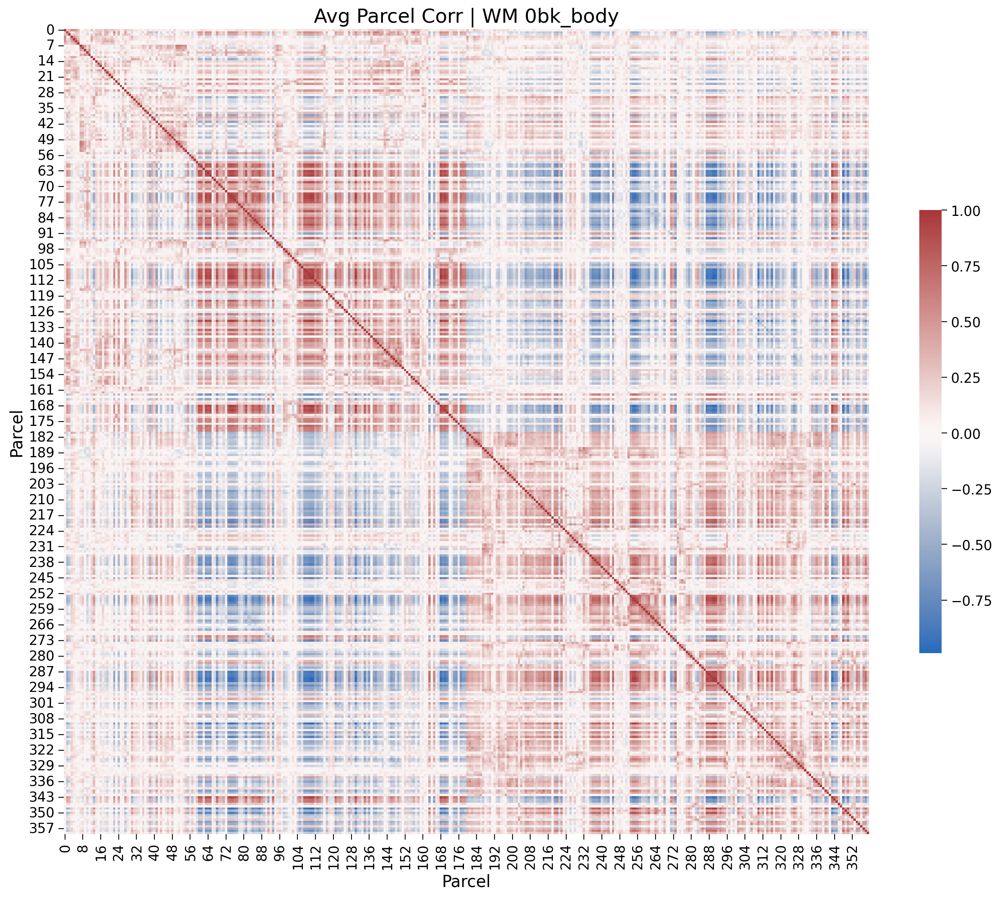

...

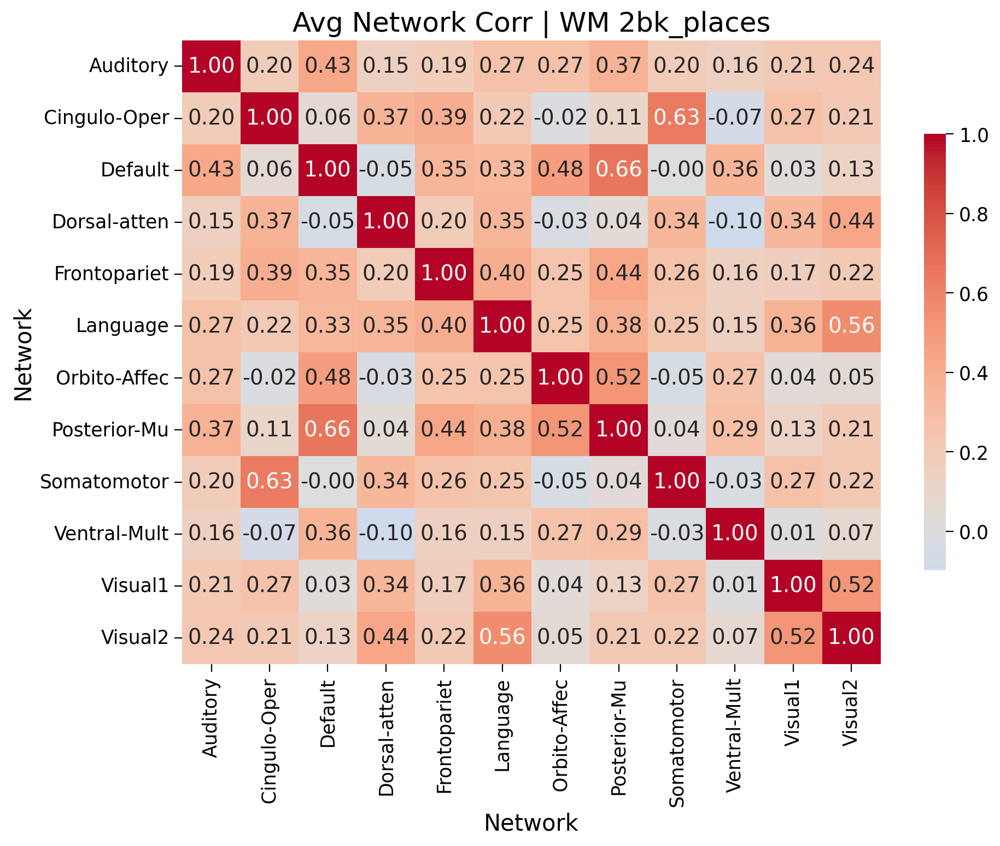

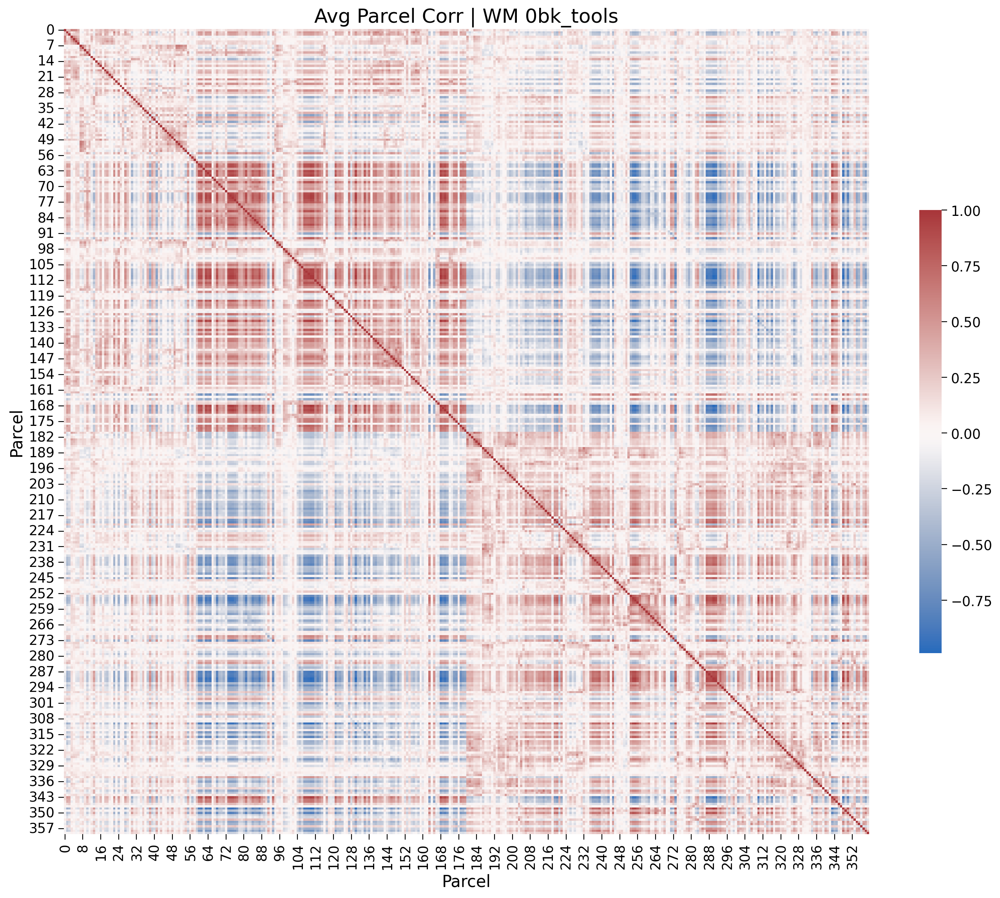

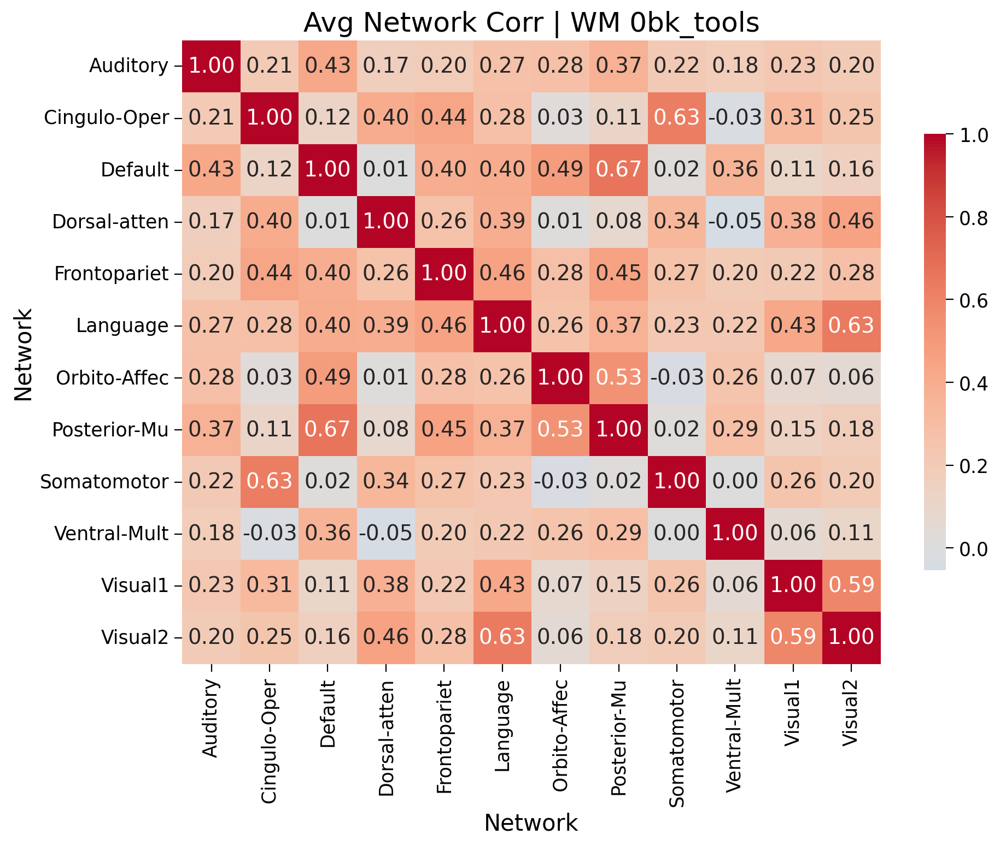

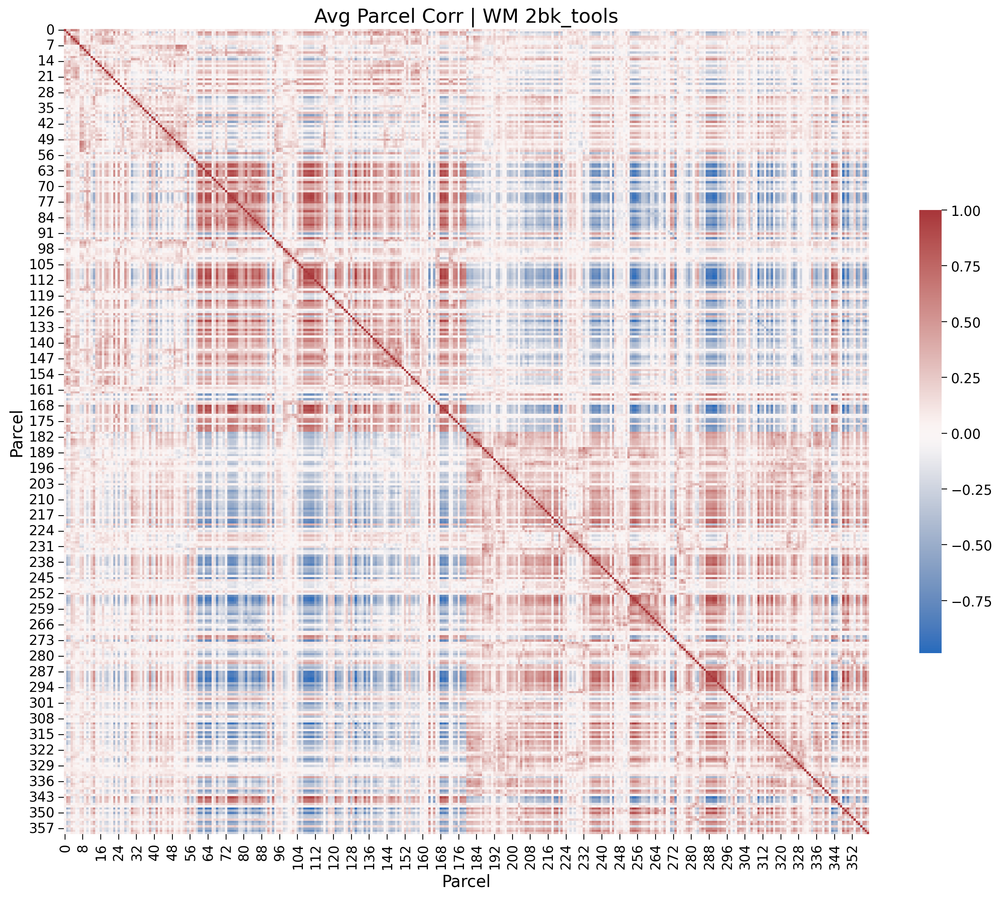

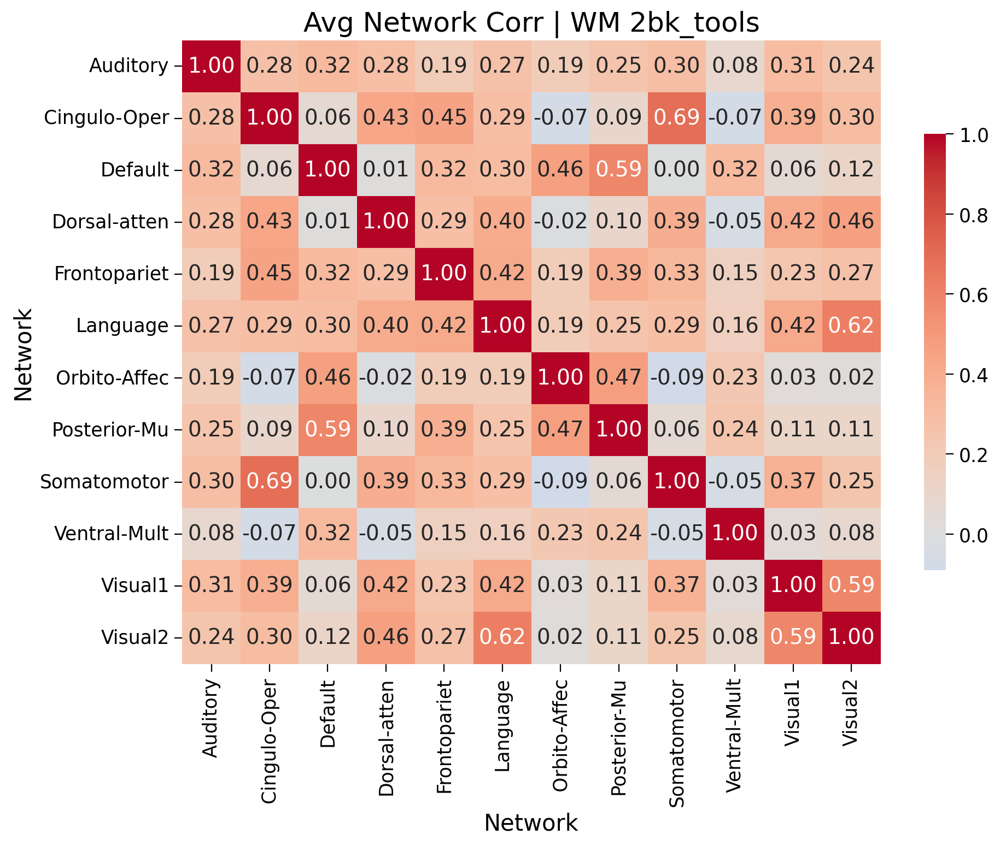

In [9]:
avg_parcels_0bk_faces, avg_networks_0bk_faces = compute_and_plot_avg_correlations("WM",
    "0bk_faces", region_info, wm_data["0bk_faces"])

avg_parcels_2bk_faces, avg_networks_2bk_faces = compute_and_plot_avg_correlations("WM",
    "2bk_faces", region_info, wm_data["2bk_faces"])

avg_parcels_0bk_body, avg_networks_0bk_body = compute_and_plot_avg_correlations("WM",
    "0bk_body", region_info, wm_data["0bk_body"])

avg_parcels_2bk_body, avg_networks_2bk_body = compute_and_plot_avg_correlations("WM",
    "2bk_body", region_info, wm_data["2bk_body"])

avg_parcels_0bk_places, avg_networks_0bk_places = compute_and_plot_avg_correlations("WM",
    "0bk_places", region_info, wm_data["0bk_places"])

avg_parcels_2bk_places, avg_networks_2bk_places = compute_and_plot_avg_correlations("WM",
    "2bk_places", region_info, wm_data["2bk_places"])

avg_parcels_0bk_tools, avg_networks_0bk_tools = compute_and_plot_avg_correlations("WM",
    "0bk_tools", region_info, wm_data["0bk_tools"])

avg_parcels_2bk_tools, avg_networks_2bk_tools = compute_and_plot_avg_correlations("WM",
    "2bk_tools", region_info, wm_data["2bk_tools"])

Permutations: 100%|██████████| 5000/5000 [00:00<00:00, 29206.86it/s]


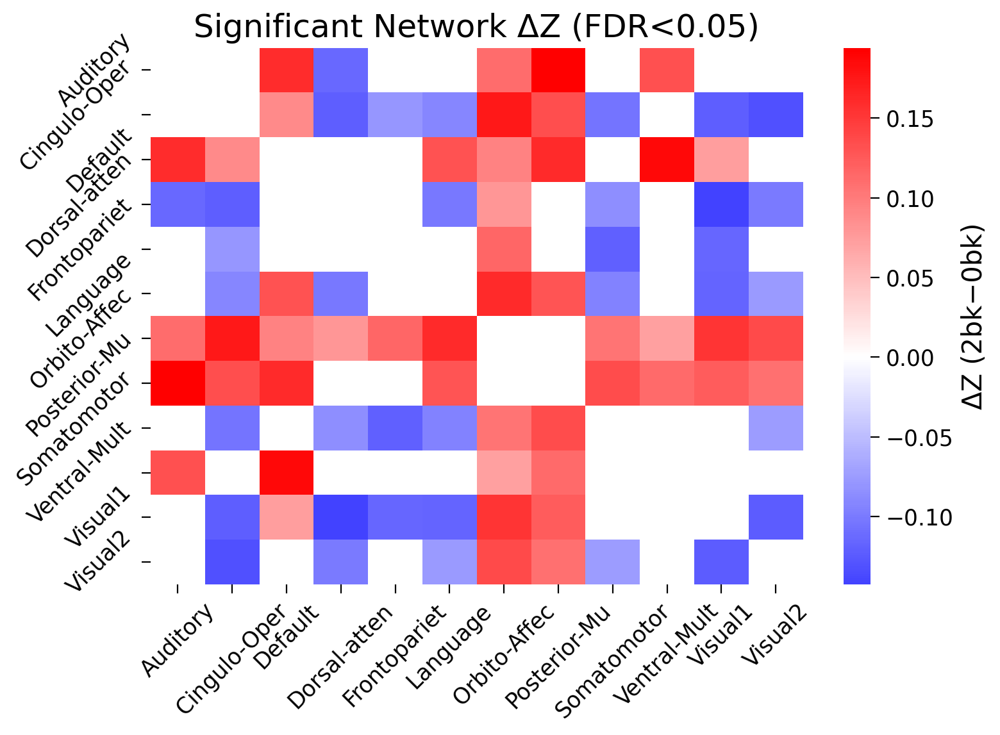

       Network A     Network B        ΔZ   p-val
3       Auditory  Posterior-Mu  0.194029  0.0002
17       Default  Ventral-Mult  0.186975  0.0002
9   Cingulo-Oper  Orbito-Affec  0.175014  0.0002
27      Language  Orbito-Affec  0.160597  0.0002
16       Default  Posterior-Mu  0.160410  0.0002
0       Auditory       Default  0.159244  0.0002
34  Orbito-Affec       Visual1  0.152622  0.0002
22  Dorsal-atten       Visual1 -0.142558  0.0002
35  Orbito-Affec       Visual2  0.136355  0.0002
36  Posterior-Mu   Somatomotor  0.135403  0.0006
              n_signif_edges
Auditory                   5
Cingulo-Oper               9
Default                    7
Dorsal-atten               7
Frontopariet               4
Language                   8
Orbito-Affec              10
Posterior-Mu               8
Somatomotor                7
Ventral-Mult               4
Visual1                    8
Visual2                    7


<Figure size 600x400 with 0 Axes>

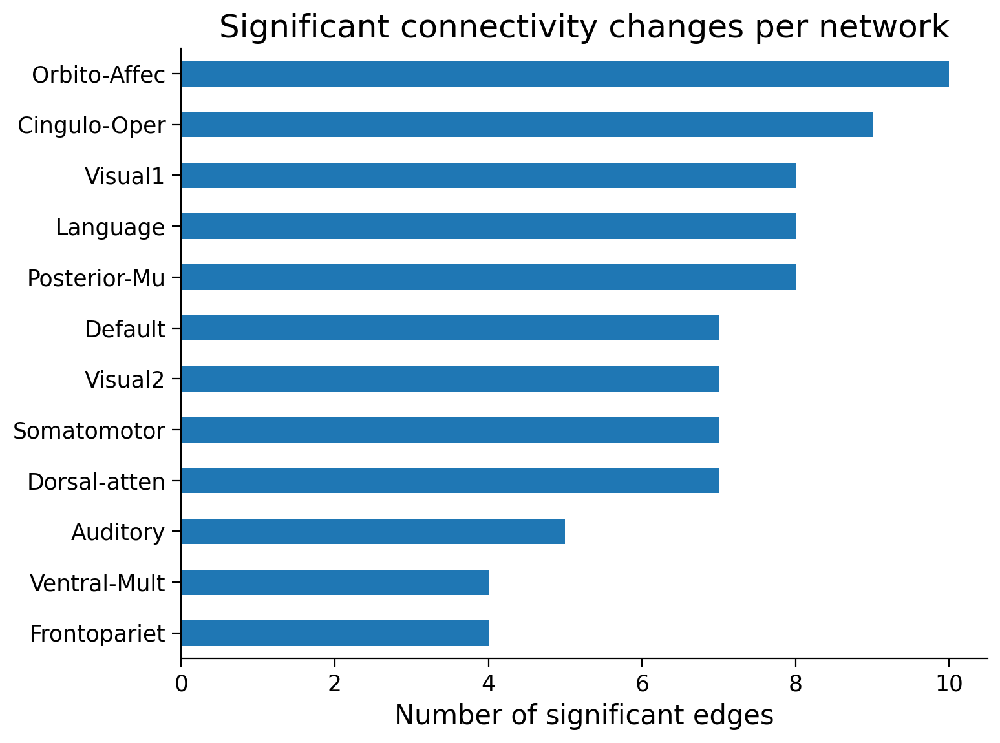

In [ ]:
from tqdm import trange
from nilearn.connectome import sym_matrix_to_vec, vec_to_sym_matrix
from statsmodels.stats.multitest import fdrcorrection

def group_network_permutation_lowmem(
    data1, data2, network_labels, n_perm=5000, fdr_alpha=0.05, seed=0
):
    """
    Permutation test on network×network connectivity differences.

    Args:
      data1, data2: arrays (S, P, T) per condition
      network_labels: length-P array of network names (strings or ints)
      n_perm: permutations
      fdr_alpha: FDR threshold
      seed: RNG seed

    Returns:
      mean_diff_z: (N, N) avg ΔZ matrix
      p_mat:        (N, N) p‑value matrix
      sig_mat:    (N, N) boolean mask of FDR‑significant edges
    """
    rng = np.random.default_rng(seed)
    S, P, _ = data1.shape

    # 1. Aggregate parcel TS → network TS per subject
    nets = np.unique(network_labels)
    N   = len(nets)
    net_ts1 = np.zeros((S, N, data1.shape[2]))
    net_ts2 = np.zeros_like(net_ts1)
    for i in range(S):
        df1 = pd.DataFrame(data1[i].T, columns=network_labels)
        df2 = pd.DataFrame(data2[i].T, columns=network_labels)
        net_ts1[i] = df1.T.groupby(level=0).mean().values
        net_ts2[i] = df2.T.groupby(level=0).mean().values

    # 2. Correlations
    R1 = np.stack([np.corrcoef(net_ts1[i]) for i in range(S)], axis=0)
    R2 = np.stack([np.corrcoef(net_ts2[i]) for i in range(S)], axis=0)
    R1 = np.clip(R1, -0.9999, 0.9999)
    R2 = np.clip(R2, -0.9999, 0.9999)

    # 3. Fisher transform
    Z1 = np.arctanh(R1)
    Z2 = np.arctanh(R2)

    # 4. Differences
    D = Z2 - Z1  # (S, N, N)

    # 5. Vectorize upper triangle
    dvecs = sym_matrix_to_vec(D, discard_diagonal=True)  # (S, E)
    E = dvecs.shape[1]

    # 6. Observed mean
    obs_mean = dvecs.mean(axis=0)
    abs_obs  = np.abs(obs_mean)

    # 7. Permutations (online counting)
    counts = np.zeros(E, dtype=int)
    for _ in trange(n_perm, desc="Permutations"):
        signs    = rng.choice([1, -1], size=(S,1))
        perm_mean= (dvecs * signs).mean(axis=0)
        counts  += (np.abs(perm_mean) >= abs_obs)

    # 8. Empirical p‑values
    pvals = (counts + 1) / (n_perm + 1)

    # 9. Rebuild matrices
    diag_zero = np.zeros(N)
    diag_one  = np.ones(N)
    mean_diff_z = vec_to_sym_matrix(obs_mean, diagonal=diag_zero)
    p_mat       = vec_to_sym_matrix(pvals,   diagonal=diag_one)

    # 10. FDR correction
    reject, _ = fdrcorrection(pvals, alpha=fdr_alpha, method="indep")
    sig_mat   = vec_to_sym_matrix(reject.astype(float), diagonal=np.zeros(N)).astype(bool)

    return nets, mean_diff_z, p_mat, sig_mat

# — Example usage for WM faces networks —
nets, mean_dz, p_mat, sig_mat = group_network_permutation_lowmem(
    data1=wm_data["0bk_faces"],
    data2=wm_data["2bk_faces"],
    network_labels=region_info["network"],
    n_perm=5000,
    fdr_alpha=0.05,
    seed=42
)

# --- Static plot of significant network ΔZ ---
plt.figure(figsize=(8,6))
sns.heatmap(
    mean_dz,
    mask=~sig_mat,
    cmap="bwr", center=0,
    xticklabels=nets, yticklabels=nets,
    cbar_kws={"label":"ΔZ (2bk−0bk)"}
)
plt.title("Significant Network ΔZ (FDR<0.05)")
plt.xticks(rotation=45)
plt.yticks(rotation=45)
plt.tight_layout()
plt.show()

# --- Interactive Plotly heatmap ---
fig = px.imshow(
    mean_dz,
    labels=dict(x="Network", y="Network", color="ΔZ"),
    x=nets, y=nets,
    title="Network ΔZ (Interactive) — significant only",
    color_continuous_scale="RdBu",
    zmin=-np.max(np.abs(mean_dz)), zmax=np.max(np.abs(mean_dz))
)
# mask non-significant by setting those cells to NaN
mask_vals = mean_dz.copy()
mask_vals[~sig_mat] = np.nan
fig = px.imshow(
    mask_vals,
    labels=dict(x="Network", y="Network", color="ΔZ"),
    x=nets, y=nets,
    title="Significant Network ΔZ (Interactive — FDR<0.05)",
    color_continuous_scale="RdBu",
    zmin=-np.nanmax(np.abs(mask_vals)), zmax=np.nanmax(np.abs(mask_vals))
)
fig.update_layout(width=700, height=700)
fig.show()

signif_edges = []
N = mean_dz.shape[0]
for i in range(N):
    for j in range(i+1, N):
        if sig_mat[i, j]:
            signif_edges.append((nets[i], nets[j], mean_dz[i, j], p_mat[i, j]))

df_edges = pd.DataFrame(signif_edges, columns=["Network A", "Network B", "ΔZ", "p-val"])
df_edges["absΔZ"] = df_edges["ΔZ"].abs()
df_edges = df_edges.sort_values("absΔZ", ascending=False).drop(columns="absΔZ")
print(df_edges.head(10))

counts = {}
for a, b, _, _ in signif_edges:
    counts[a] = counts.get(a, 0) + 1
    counts[b] = counts.get(b, 0) + 1

df_counts = pd.DataFrame.from_dict(counts, orient="index", columns=["n_signif_edges"])
df_counts = df_counts.loc[nets] 
print(df_counts)

plt.figure(figsize=(6,4))
df_counts.sort_values("n_signif_edges").plot.barh(legend=False)
plt.xlabel("Number of significant edges")
plt.title("Significant connectivity changes per network")
plt.tight_layout()
plt.show()

# Models

Model 1: Classifing 0 back and 2 back data